# Setup: Import and git clone


We retrieve the public IO repository here. This contains all
code necessary to run the full IO model, but that doesn't
work without a GPU. So here we just use it to obtain the 
mechanism files

In [6]:
import os
if not os.path.exists('iopublic'):
    !git clone --depth 1 'https://github.com/llandsmeer/iopublic'
import matplotlib.pyplot as plt
%matplotlib inline
import random, numpy as np
import plotly.express as px
import pandas as pd
random.seed(0)
np.random.seed(0)
import arbor
import networkx as nx

ModuleNotFoundError: No module named 'arbor'

# Mechanisms: Compile & load NMODL files

Now, we need to compile these nmodl files to an arbor dynamically loadable library using the `arbor-build-catalogue` command

In [4]:
!arbor-build-catalogue io iopublic/smol_model --cxx g++

# We can not load the Inferior Olive (IO) catalogue 
io_catalogue = arbor.load_catalogue('./io-catalogue.so')
print('io_catalogue contents:', ' '.join(io_catalogue.keys()))

/bin/bash: arbor-build-catalogue: command not found


NameError: name 'arbor' is not defined

# Decor: Define which mechanisms go where

The decor defines (among other) how our custom IO catalogue mechanisms map onto the morphologies. We have some built-in variation in cell parameters using the R() function.

In [ ]:
def decor_default(variance=0.2):
    def R(x):
        r = random.gauss(x, x*variance)
        if abs(r) < 0.3 * abs(x):  return x
        return r
    return (arbor.decor()
        .paint('"soma"', arbor.density('na_s', dict(gmax=R(0.030))))
        .paint('"soma"', arbor.density('kdr',  dict(gmax=R(0.030))))
        .paint('"soma"', arbor.density('cal',  dict(gmax=R(0.025)))) # 45
        .paint('"dend"', arbor.density('cah',  dict(gmax=R(0.010))))
        .paint('"dend"', arbor.density('kca',  dict(gmax=R(0.220))))
        .paint('"dend"', arbor.density('h',    dict(gmax=R(0.015))))
        .paint('"dend"', arbor.density('cacc', dict(gmax=R(0.000))))
        .paint('"axon"', arbor.density('na_a', dict(gmax=R(0.200))))
        .paint('"axon"', arbor.density('k',    dict(gmax=R(0.200))))
        .paint('"soma"', arbor.density('k',    dict(gmax=R(0.015))))
        .paint('"all"',  arbor.density('leak', dict(gmax=R(1.3e-05))))
        .set_property(cm=0.01) # Ohm.cm
        .set_property(Vm=-R(65.0))
        .paint('"all"', rL=100) # Ohm.cm
        .paint('"all"', ion_name='ca', rev_pot=R(120), int_con=3.7152)
        .paint('"all"', ion_name='na', rev_pot=R(55))
        .paint('"all"', ion_name='k', rev_pot=-R(75))
        .paint('"all"', arbor.density('ca_conc'))
    )

# Recipe: Putting everything together

We can not go on with defining the recipe

In [2]:
LABELS_DEFAULT = {
    'soma': '(tag 1)',
    'axon': '(tag 2)',
    'dend': '(tag 3)',
    'all' : '(all)',
    'root': '(root)'
}

class NetworkIO(arbor.recipe):
    def __init__(self, ncells, cluster_coef=0.8, k=4, variance=0.2, gj_conductance=0.002):
        super().__init__()
        self.variance = variance
        self.gj_conductance = gj_conductance
        self.ncells = ncells
        self.props = arbor.neuron_cable_properties()
        self.props.catalogue.extend(io_catalogue, '')
        self.dend_count = 10
        self.conns = {}
        self.k = k
        if ncells > 1:
            A = build_connection_matrix(cluster_coef=cluster_coef, ncells=self.ncells, cluster_size=k)
            for i, j in zip(*np.where(A)):
                self.conns[min(i, j), max(i, j)] = random.randrange(0, self.dend_count), random.randrange(0, self.dend_count)

    def cell_description(self, gid):
        # starfish topology with gap junctions at each dend end
        #    gj0        gj1
        #      \        /
        #      dend   dend
        #           \  /
        #  --axon--- SOMA----dend---gj2
        #            /  \
        #         dend  dend
        #          /       \
        #        gj4       gj3
        tree = arbor.segment_tree()
        soma = tree.append(arbor.mnpos, arbor.mpoint(-12, 0, 0, 12), arbor.mpoint(0, 0, 0, 12), tag=1)
        tree.append(soma, arbor.mpoint(-random.randrange(-50, -40), 0, 0, 2), arbor.mpoint(-12, 0, 0, 2), tag=2) # axon
        labels_dict = LABELS_DEFAULT.copy()
        decor = decor_default(variance=self.variance)
        for i in range(self.dend_count):
            tree.append(soma, arbor.mpoint(6, 0, 0, 2), arbor.mpoint(random.randint(180, 250), 0, 0, 2), tag=3) # dend
            labels_dict[f'gj{i}'] = '(location 0 1)'
            decor.place(f'"gj{i}"', arbor.junction('cx36'), f'gj{i}')
        labels = arbor.label_dict(labels_dict)
        cell = arbor.cable_cell(tree, decor, labels)
        return cell

    def gap_junctions_on(self, gid):
        conns = []
        for other in range(self.num_cells()):
            if other == gid: continue
            a, b = min(gid, other), max(gid, other)
            if (a, b) in self.conns:
                i, j = self.conns[a, b]
                if b == gid:
                    i, j = j, i
                conns.append(arbor.gap_junction_connection((other, f'gj{i}'), f'gj{j}', self.gj_conductance))
        return conns
    def num_cells(self): return self.ncells
    def cell_kind(self, gid): return arbor.cell_kind.cable
    def probes(self, gid): return [arbor.cable_probe_membrane_voltage('"root"')]
    def global_properties(self, kind): return self.props

    def simulate(self, tfinal, dt=0.025):
        sim = arbor.simulation(self)
        # helper funtion to simulate and obtain voltage traces
        handles = [sim.sample((gid, 0), arbor.regular_schedule(1)) for gid in range(recipe.num_cells())]
        sim.progress_banner()
        sim.run(tfinal=tfinal, dt=dt)
        df_list = []
        for gid, handle in enumerate(handles):
            samples, meta = sim.samples(handle)[0]
            df_list.append(pd.DataFrame({"t/ms": samples[:, 0], "U/mV": samples[:, 1], 'Cluster': gid // self.k, "Cell": f"Neuron {gid}"}))
        return pd.concat(df_list, ignore_index=True)

NameError: name 'arbor' is not defined

# Single cell: Simulate a single voltage trace

Let's start with simulating a single cell. As expected, subthreshold oscillations are clearly visible

100% |--------------------------------------------------|          6000ms


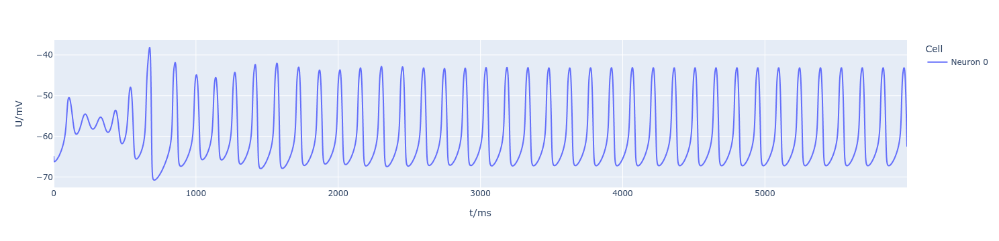

In [5]:
random.seed(0)
recipe = NetworkIO(ncells=1, variance=0)
df = recipe.simulate(6000)
px.line(df, x='t/ms', y='U/mV', color='Cell')

# Network: Simulate an IO network

Now, let's simulate a clustered network. We will have 2 builtin clusters, and simulate 2 networks: one with a high clustering coefficient, one with a low cluster coefficient (visualized below)

In [17]:
def build_connection_matrix(cluster_coef, ncells, cluster_size):
    'this function defines a IO network with variable amount of clustering'
    if ncells == 1: return np.array([[False]])
    Amask = np.kron(np.eye(int(np.ceil(ncells / cluster_size))), np.ones((cluster_size, cluster_size)))[:ncells,:ncells]
    A = np.random.random((ncells, ncells)) * Amask
    A = (A + A.T)/2
    A = A / A.sum()
    B = np.random.random((ncells, ncells))
    B = (B + B.T)/2
    B = B / B.sum()
    P = cluster_coef * A + (1-cluster_coef) * B
    np.fill_diagonal(P, 0)
    p = np.sort(P.flatten())[::-1]
    p = p[min(ncells * 10, ncells*ncells)]
    return P > p

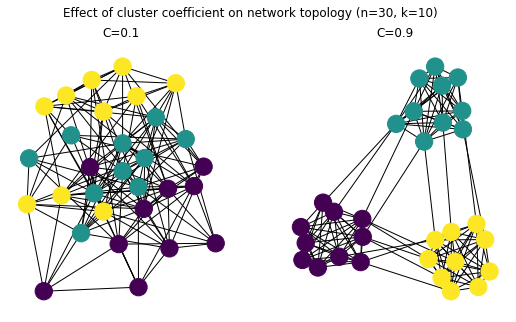

In [18]:
n, k, k1, k2 = 30, 10, 0.1, 0.9
tstop = 7000
colormap = sum(([i]*k for i in range(int(np.ceil(n / k)))), [])
fig, ax = plt.subplots(ncols=2, figsize=(9, 5))
fig.suptitle(f'Effect of cluster coefficient on network topology (n={n}, k={k})')
ax[0].set_title(f'C={k1}')
ax[1].set_title(f'C={k2}')
G = nx.from_numpy_array(build_connection_matrix(k1, n, k))
H = nx.from_numpy_array(build_connection_matrix(k2, n, k))
nx.draw(G, ax=ax[0], node_color=colormap)
nx.draw(H, ax=ax[1], node_color=colormap)

100% |--------------------------------------------------|          7000ms
CPU times: user 5.6 s, sys: 11.7 ms, total: 5.61 s
Wall time: 5.61 s


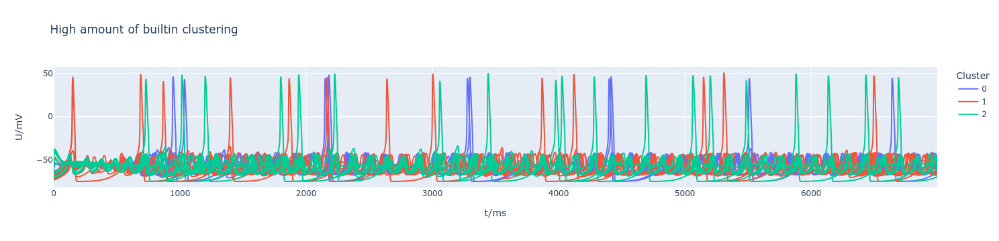

In [19]:
%%time
# simulation takes about 25 seconds

random.seed(0)
recipe = NetworkIO(ncells=n, k=k, cluster_coef=k2, variance=0.1)
df = recipe.simulate(tstop)
Vhigh = df.pivot(index='t/ms', columns='Cell', values='U/mV').values
px.line(df, x='t/ms', y='U/mV', color='Cluster', line_group='Cell', title='High amount of builtin clustering')

100% |--------------------------------------------------|          7000ms
CPU times: user 5.79 s, sys: 27.6 ms, total: 5.82 s
Wall time: 5.82 s


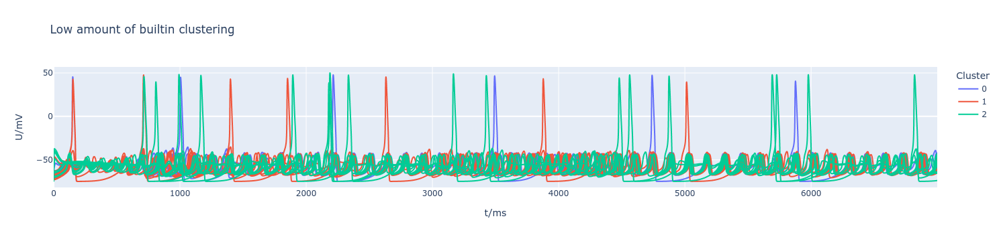

In [20]:
%%time
random.seed(0)
recipe = NetworkIO(ncells=n, k=k, cluster_coef=k1, variance=0.1)
df = recipe.simulate(tstop)
Vlow = df.pivot(index='t/ms', columns='Cell', values='U/mV').values
px.line(df, x='t/ms', y='U/mV', color='Cluster', line_group='Cell', title='Low amount of builtin clustering')

# Visualize: Visualize cluster dynamics

Analysis: Hierarchical Clustering of the Analytical Signal

We have saved the voltage traces in the variables `Vhigh` and `Vlow` for respectively the high and low cluser coefficient networks.

First, we calculate the analytical signal (the phases) by filtering using a bandpass filter around the approximate expected STO frequency and then taking the Hilbert transform.

In [21]:
import scipy.signal

def get_analytical(vsall):
    fs = 1000
    vs = np.copy(vsall.T)
    vs = (vs - vs.mean(1)[:,None]) / vs.std(1)[:,None]
    vs[vs > 2] = 2
    vs[vs < -2] = -2
    sos = scipy.signal.butter(5, (2, 20), 'bp', fs=fs, output='sos')
    filt = scipy.signal.sosfiltfilt(sos, vs)
    analytic = scipy.signal.hilbert(filt - filt.mean())
    return np.angle(analytic)

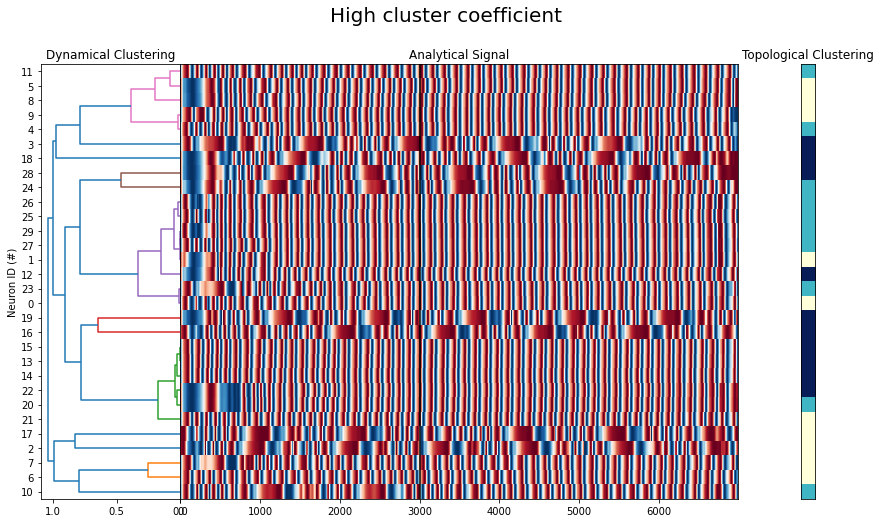

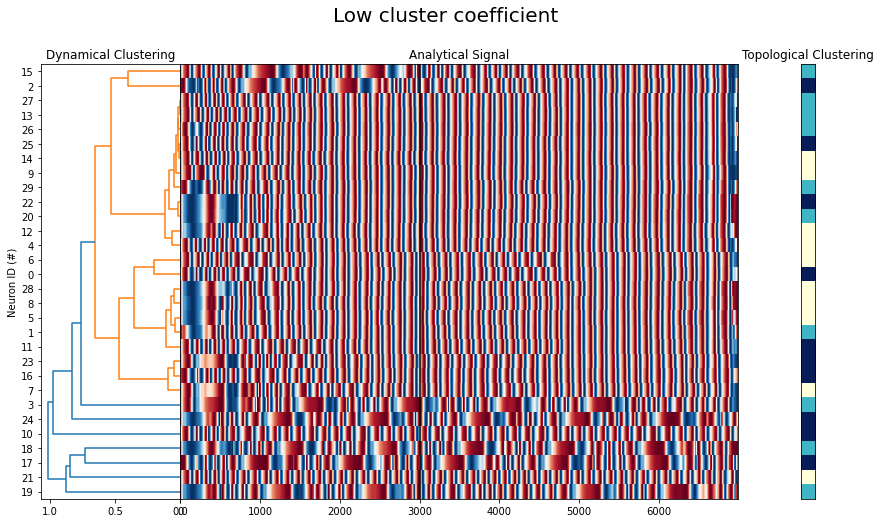

In [22]:
import scipy.cluster.hierarchy as sch

def plot3(A, title, method='weighted', cmap='YlGnBu', skip_transient=3000):
    fig, ax = plt.subplots(ncols=3, figsize=(15, 8), gridspec_kw=dict(wspace=0, width_ratios=[1, 4, 1]))
    fig.suptitle(title, fontsize=20)
    d = sch.dendrogram(sch.linkage(np.sin(A[:,skip_transient:]), metric='correlation', method=method), orientation='left', ax=ax[0])
    idx = d['leaves']
    ax[0].set_ylabel('Neuron ID (#)')
    ax[1].imshow(np.sin(A[idx][::-1]), aspect='auto', cmap='RdBu', interpolation='nearest')
    ax[1].set_yticks([])
    ax[2].imshow(np.array(idx)[:,None]//k, cmap=cmap)
    ax[2].set_xticks([])
    ax[2].set_yticks([])
    ax[0].yaxis.tick_left()
    ax[0].set_title('Dynamical Clustering')
    ax[1].set_title('Analytical Signal')
    ax[2].set_title('Topological Clustering')
    ax[1].axvline(skip_transient, color='black', zorder=10)

Ahigh = get_analytical(Vhigh)
Alow = get_analytical(Vlow)
method = 'weighted' # single, complete, average, weighted
plot3(Ahigh, 'High cluster coefficient', method=method)
plot3(Alow, 'Low cluster coefficient', method=method)

# Quantify: Effect topology->synchrony

Warning! The boxplot shows sampled NMI estimates *from the same simulation*. This is because Kmeans returns different results based on the initial seed.

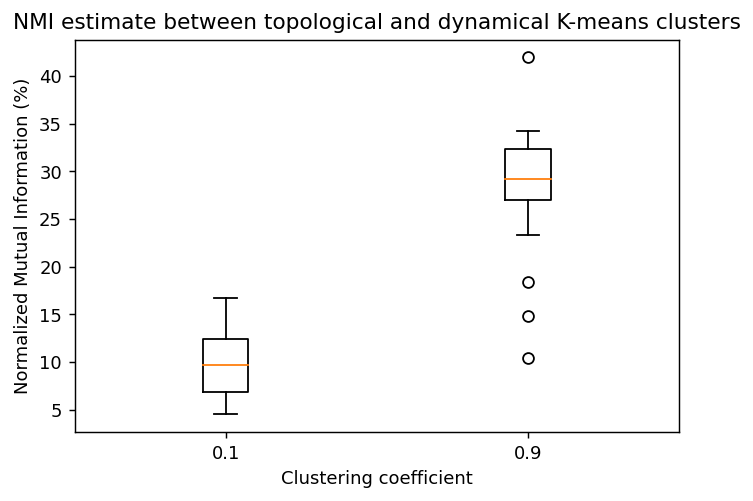

In [24]:
from sklearn.metrics import normalized_mutual_info_score as nmi
Ltrue = np.arange(n) // k
def kmeans_labels(A):
    return scipy.cluster.vq.kmeans2(np.sin(A[:,3000:]), 3, minit='++', iter=100)[1]
ntrials = 30
NMI_high = [100*nmi(Ltrue, kmeans_labels(Ahigh)) for _ in range(ntrials)]
NMI_low = [100*nmi(Ltrue, kmeans_labels(Alow)) for _ in range(ntrials)]

plt.figure(dpi=130)
plt.boxplot([NMI_low, NMI_high], labels=[k1, k2]);
plt.xlabel('Clustering coefficient')
plt.ylabel('Normalized Mutual Information (%)')
plt.title('NMI estimate between topological and dynamical K-means clusters');